# Analyse Deaths involving Police in the United States
Analysis, Comparison, and Optinion

In [135]:
#import the Libraries

# standard Libraries
import os
import re
from datetime import datetime, timedelta
import pandas as pd
import numpy as np

# used for displaying data and stuff
from IPython.display import display, HTML 

# used for charts and Graphs
import plotly
import plotly.express as px
import seaborn as sns

# set pandas options
# show all the columns and rows
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

## An Analysis of Washington Post's Data
source: https://www.washingtonpost.com/graphics/investigations/police-shootings-database/
> note the Washington Post is owned by Jeff Bezos and therefore their views on various topics may or may-not be influenced by their ownership
> please see https://spectator.org/the-washington-posts-brazen-lies/ for more on this side topic


**a bit of background**

`id`: a unique identifier for each victim

`name`: the name of the victim

`date`: the date of the fatal shooting in YYYY-MM-DD format

`manner_of_death`:
- `shot`
- `shot and Tasered`

`armed`: indicates that the victim was armed with some sort of implement that a police officer believed could inflict harm
- `undetermined`: it is not known whether or not the victim had a weapon
- `unknown`: the victim was armed, but it is not known what the object was
- `unarmed`: the victim was not armed

`age`: the age of the victim

`gender`: the gender of the victim. The Post identifies victims by the gender they identify with if reports indicate that it differs from their biological sex.
- `M`: Male
- `F`: Female
- `None`: unknown

`race`:
- `W`: White, non-Hispanic
- `B`: Black, non-Hispanic
- `A`: Asian
- `N`: Native American
- `H`: Hispanic
- `O`: Other
- `None`: unknown

`city`: the municipality where the fatal shooting took place. Note that in some cases this field may contain a county name if a more specific municipality is unavailable or unknown.

`state`: two-letter postal code abbreviation

`signs of mental illness`: News reports have indicated the victim had a history of mental health issues, expressed suicidal intentions or was experiencing mental distress at the time of the shooting.

`threat_level`: The threat_level column was used to flag incidents for the story by Amy Brittain in October 2015. http://www.washingtonpost.com/sf/investigative/2015/10/24/on-duty-under-fire/ As described in the story, the general criteria for the attack label was that there was the most direct and immediate threat to life. That would include incidents where officers or others were shot at, threatened with a gun, attacked with other weapons or physical force, etc. The attack category is meant to flag the highest level of threat. The other and undetermined categories represent all remaining cases. Other includes many incidents where officers or others faced significant threats.

`flee`: News reports have indicated the victim was moving away from officers
- `Foot`
- `Car`
- `Not fleeing`

The threat column and the fleeing column are not necessarily related. For example, there is an incident in which the suspect is fleeing and at the same time turns to fire at gun at the officer. Also, attacks represent a status immediately before fatal shots by police while fleeing could begin slightly earlier and involve a chase.

`body_camera`: News reports have indicated an officer was wearing a body camera and it may have recorded some portion of the incident.

`latitude` and `longitude`: the location of the shooting expressed as WGS84 coordinates, geocoded from addresses. The coordinates are rounded to 3 decimal places, meaning they have a precision of about 80-100 meters within the contiguous U.S.

`is_geocoding_exact`: reflects the accuracy of the coordinates. `true` means that the coordinates are for the location of the shooting (within approximately 100 meters), while `false` means that coordinates are for the centroid of a larger region, such as the city or county where the shooting happened.

In [136]:
dfwp = pd.read_csv("data-police-shootings/fatal-police-shootings-data.csv")

dfwp = dfwp.set_index("id",drop=True)
dfwp = dfwp.fillna('N/A')

# lets add a year column to group by later 
dfwp['YYYY'] = pd.to_datetime(dfwp['date']).dt.strftime("%Y") 

In [137]:
# Shape, Head, Columns, and Info
print("shape\n",dfwp.shape)
print("#" * 50)
print("hean",dfwp.head())
print("#" * 50)
print("columns\n",dfwp.columns)
print("#" * 50)
print("info\n",dfwp.info())

shape
 (7853, 17)
##################################################
hean                   name        date   manner_of_death       armed   age gender  \
id                                                                              
3           Tim Elliot  2015-01-02              shot         gun  53.0      M   
4     Lewis Lee Lembke  2015-01-02              shot         gun  47.0      M   
5   John Paul Quintero  2015-01-03  shot and Tasered     unarmed  23.0      M   
8      Matthew Hoffman  2015-01-04              shot  toy weapon  32.0      M   
9    Michael Rodriguez  2015-01-04              shot    nail gun  39.0      M   

   race           city state  signs_of_mental_illness threat_level  \
id                                                                   
3     A        Shelton    WA                     True       attack   
4     W          Aloha    OR                    False       attack   
5     H        Wichita    KS                    False        other   
8     W 

### Stats

In [138]:
temp = dfwp.copy()
temp['count'] = 1

# deaths per year
dfdpy = temp.groupby("YYYY").sum("count")
dfdpy = dfdpy.reset_index()

print('Avg: ',dfdpy["count"].mean())
print('Min: ',dfdpy["count"].min())
print('Max: ',dfdpy["count"].max())
print()
print(dfdpy[["YYYY","count"]])


Avg:  981.625
Min:  856
Max:  1053

   YYYY  count
0  2015    994
1  2016    958
2  2017    981
3  2018    992
4  2019    999
5  2020   1020
6  2021   1053
7  2022    856


### Histograms and Other Charts

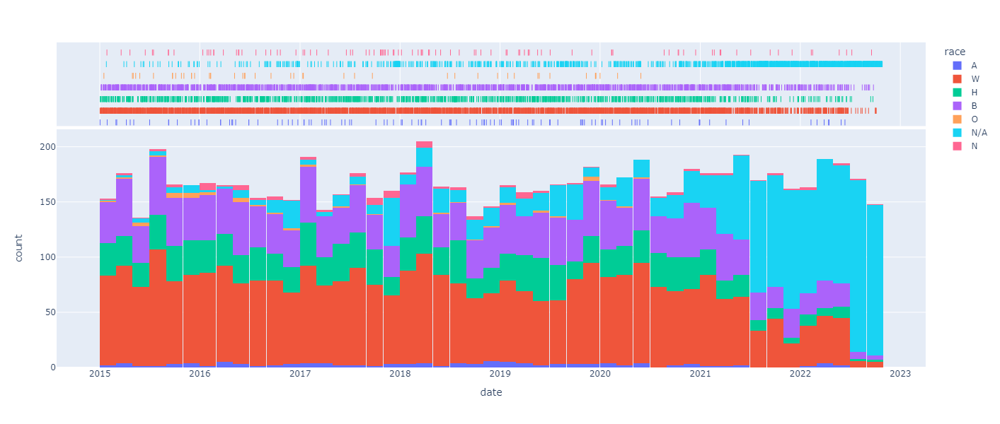

In [139]:
display(HTML("<h4> Histogram -- date and race</h4>"))
display(HTML("*there was a sharp decrease in reporting on race around mid/late 2021"))

fig = px.histogram(
    dfwp, 
    x='date',
    color='race',
    marginal="rug",
    hover_data=dfwp.columns,
    height=600
    )
fig.show()


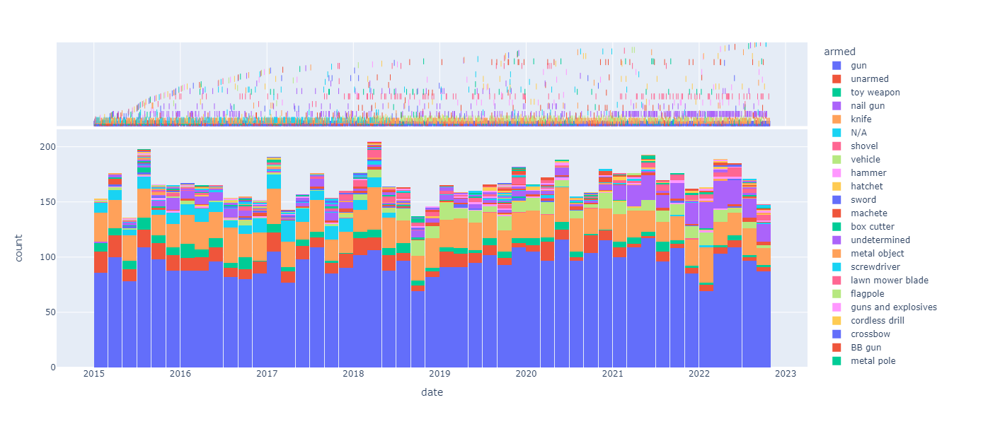

In [140]:
display(HTML("<h4> Histogram -- date and armed/weapon</h4>"))
display(HTML("it's nice that most of these are real threats (aka a gun), however it would be nice to see a decrease all all non-threatening objects"))

fig = px.histogram(
    dfwp, 
    x='date',
    color='armed',
    marginal="rug",
    hover_data=dfwp.columns,
    height=600
    )
fig.show()

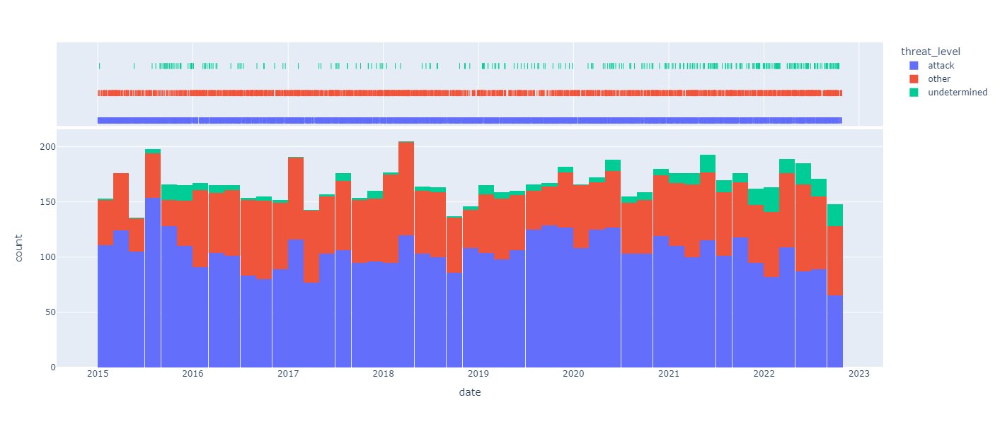

In [141]:
display(HTML("<h4> Histogram -- date and threat_level</h4>"))
display(HTML("*after an attack it makes sense that police would shoot to save lives of themselvs and others"))
display(HTML("- however it would be nice to see a decrease the other two categories here."))

fig = px.histogram(
    dfwp, 
    x='date',
    color='threat_level',
    marginal="rug",
    hover_data=dfwp.columns,
    height=600
    )
fig.show()

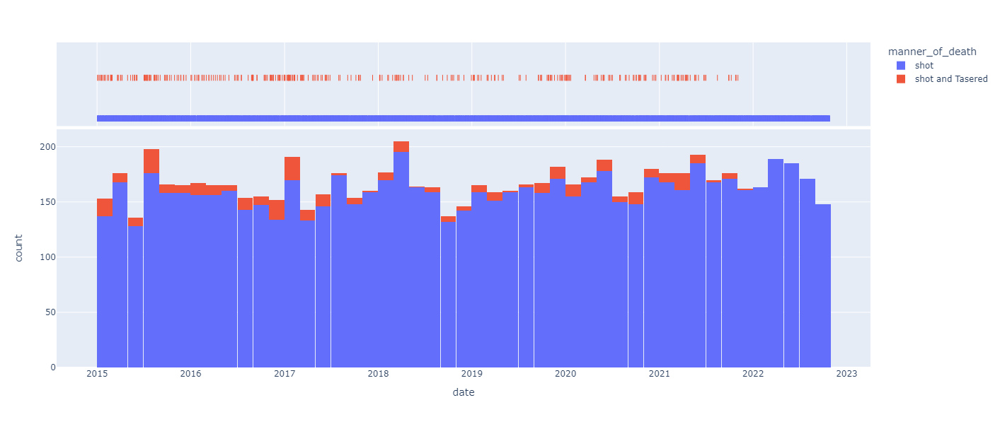

In [142]:
display(HTML("<h4> Histogram -- date and manner_of_death</h4>"))

fig = px.histogram(
    dfwp, 
    x='date',
    color='manner_of_death',
    marginal="rug",
    hover_data=dfwp.columns,
    height=600
    )
fig.show()

## Defunding the Police ?
source: https://opendata.minneapolismn.gov/datasets/cityoflakes::crime-data/about

As a person of science, i feel we need to conduct an experiment.    
however since no one going to give me total control of a two or mode identical cities...  
i must feel satisfied by using the imperfect data that i can get.  

According to this article (https://opendata.minneapolismn.gov/datasets/cityoflakes::crime-data/about).
the police were partically defunded.

excerpt:  
"
So, it’s incorrect to say the police department has been defunded, as in, an overhaul or abolition of MPD as we know it.  

But, it does depend how you’re defining “defunded.”  

The City Council moved $1.1 million from the police to the health department to fund “violence interrupters” who would mediate conflicts and head off further trouble.  

Some people think of defunding as shifting money from police departments to spend on other priorities, such as mental health services and other programs, to bolster public safety. Still, it’s worth noting in this case that the amount of money the council diverted is less than a percentage point of the police department’s budget.  
"
  
...  
Let's see what the data says...  


In [143]:
dfdp = pd.read_csv("Crime_Data.csv")

dfdp = dfdp.fillna('N/A')

# convert *datetime columns*
dfdp['Reported_Date'] = pd.to_datetime(dfdp['Reported_Date'],errors="ignore")
dfdp['Occurred_Date'] = pd.to_datetime(dfdp['Occurred_Date'],errors="ignore")

In [144]:
# Shape, Head, Columns, and Info
print("shape\n",dfdp.shape)
print("#" * 50)
print("hean",dfdp.head())
print("#" * 50)
print("columns\n",dfdp.columns)
print("#" * 50)
print("info\n",dfdp.info())

shape
 (200930, 24)
##################################################
hean            X          Y                    Type Case_Number Case_NumberAlt  \
0 -93.316750  45.038778  Crime Offenses (NIBRS)   19-244586   MP2019244586   
1 -93.293968  45.039344  Crime Offenses (NIBRS)   19-122255   MP2019122255   
2 -93.249955  44.949220       Shots Fired Calls   21-117936            N/A   
3 -93.275347  44.977582  Crime Offenses (NIBRS)   20-222716   MP2020222716   
4 -93.226094  44.935953  Crime Offenses (NIBRS)   20-703897   MP2020703897   

              Reported_Date           Occurred_Date NIBRS_Crime_Against  \
0 2019-08-15 21:39:00+00:00  2019/08/15 16:00:00+00           Property    
1 2019-05-01 13:10:00+00:00  2019/05/01 10:15:00+00           Property    
2 2021-06-01 07:53:55+00:00  2021/06/01 07:53:55+00      Non NIBRS Data   
3 2020-08-27 03:26:00+00:00  2020/08/26 22:54:00+00           Property    
4 2020-07-12 11:24:00+00:00  2020/07/12 09:30:00+00           Property    

    

In [145]:
# we need to drop some columns ... this data is too heavy
dfdp_min = dfdp[["Reported_Date","Occurred_Date","Offense_Category","Crime_Count","Precinct"]].copy()

# we are only looking at the 3rd precinct since ... according to the article they were the only ones impacted
dfdp_min = dfdp_min.loc[dfdp_min["Precinct"] == 3]
    
# grouping by *date* 
dfdp_min['YYYYMMDD'] = pd.to_datetime(dfdp_min['Reported_Date']).dt.strftime("%Y%m%d")
dfdp_min['YYYYMMDD'] = pd.to_datetime(dfdp_min['YYYYMMDD'])


dfdp_min = pd.pivot_table(
    dfdp_min,
    index= ["YYYYMMDD","Offense_Category"],
    values="Crime_Count",
    aggfunc={"Crime_Count":sum}
    )

dfdp_min = dfdp_min.sort_values(by='YYYYMMDD',ascending=True)
dfdp_min = dfdp_min.reset_index()

display(dfdp_min.head())

,YYYYMMDD,Offense_Category,Crime_Count
0,2019-01-01,Assault Offenses,2
1,2019-01-01,Destruction/Damage/Vandalism of Property,4
2,2019-01-01,Larceny/Theft Offenses,2
3,2019-01-01,Motor Vehicle Theft,3
4,2019-01-01,Robbery,2


### Histograms

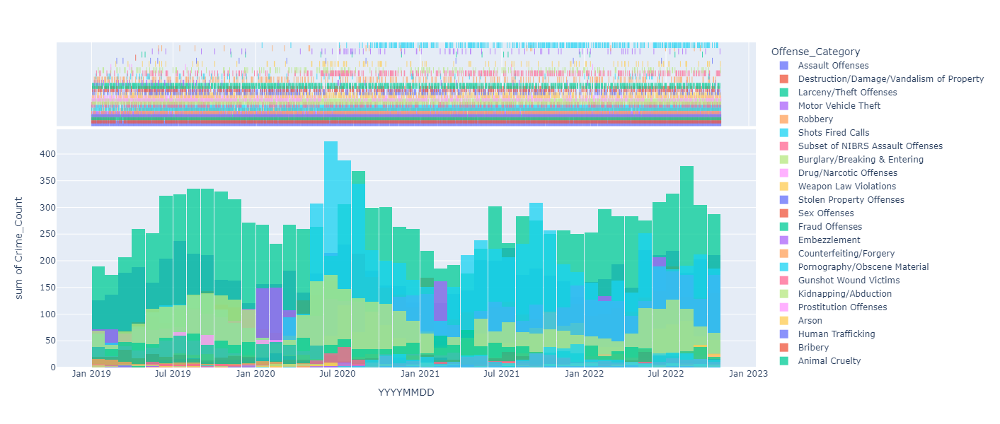

In [ ]:
display(HTML("<h4> Histogram -- Date and Crime_Count</h4>"))
display(HTML("with this view we can see that the spike in crime, occured before the change in funding."))
display(HTML("however some types of crimes (like \"Shots Fired Calls\") have **not** gone back to their original levels (before the spike), but they have dropped a bit"))
display(HTML("note: other types of crims seem to be split into multiple categories ... for example Robbery and \"Subset of NIBRS Robbery\" should be one category (IMHO) "))


fig = px.histogram(
    dfdp_min, 
    x='YYYYMMDD',
    y='Crime_Count',
    color='Offense_Category',
    marginal="rug",
    hover_data=dfdp_min.columns,
    height=600
    )
fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.75)
fig.show()

### Line Chart

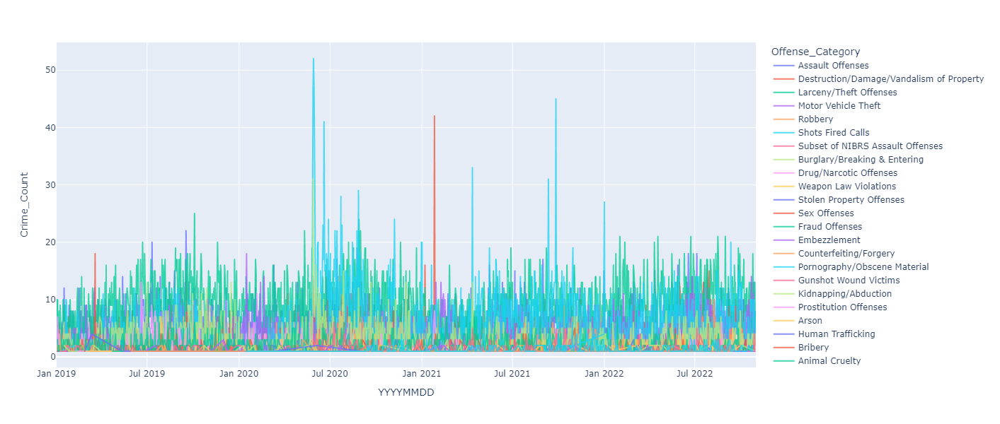

In [147]:
fig = px.line(
    dfdp_min, 
    x='YYYYMMDD', 
    y='Crime_Count',
    color='Offense_Category',
    height=600
    )
fig.update_traces(opacity=0.75)
fig.show()